# Data Augmentation

Après avoir nettoyé les données, nous pouvons maintenant procéder à l'augmentation des données. L'augmentation des données consiste à créer de nouvelles données à partir de données existantes en appliquant des transformations qui n'affecte pas les caractéristique pertinentes de l'audio.

Cela peut inclure des changements de tonalité, de vitesse, d'ajout de bruit, ect.

## Imports

In [1]:

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import soundfile as sf

import tools

# change style
plt.style.use('ggplot')
import librosa
import librosa.display

from tqdm import tqdm
from datetime import datetime

tqdm.pandas()
import os
from glob import glob
import random
from typing import List, Tuple, Dict

from concurrent.futures import ThreadPoolExecutor, as_completed
import threading
import librosa

In [2]:
from params import SOUNDS_DATASET_PATH, SAMPLE_RATE, CLASS_COLORS, AIRS_PATH, LOW_PITCHED_DRUMS, HIGH_PITCHED_DRUMS
from tools import play_audio, load_audio_file, pad_signal, get_all_audios_files



## Load Dataset

In [3]:
now_day_str = "20230511"
dataset_csv_path = os.path.join(SOUNDS_DATASET_PATH, f'dataset_features_cleaned_{now_day_str}.csv')
dataset = pd.read_csv(dataset_csv_path)
# set index
dataset.set_index('file_path', inplace=True)

print(f"Dataset shape: {dataset.shape}")
dataset

Dataset shape: (9441, 102)


,file_name,file_extension,class,split,duration,rms_log_sum,rms_log_mean,rms_log_max,rms_log_std,rms_log_diff_abs_mean,...,spec_bw_mean,spec_bw_std,spec_flatness_mean,spec_flatness_std,spec_rolloff_85_mean,spec_rolloff_85_std,spec_rolloff_15_mean,spec_rolloff_15_std,spec_contrast_mean,spec_contrast_std
file_path,,,,,,,,,,,,,,,,,,,,,
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Shaker (86).wav,Shaker (86),.wav,Shaker,train,0.271746,-67.922790,-2.830116,-0.979739,1.160011,0.201043,...,5551.947561,1167.818323,0.238786,0.060366,18053.796387,1393.806008,5028.002930,3072.527272,13.643418,3.420110
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\shaker (2) (2).wav,shaker (2) (2),.wav,Shaker,train,2.821746,-1251.780600,-5.130249,-0.586314,1.711829,0.043277,...,1086.457660,2078.200191,0.810217,0.365054,2866.563541,5542.881827,536.388560,1097.454240,9.787767,3.063742
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Shaker (85).wav,Shaker (85),.wav,Shaker,train,0.089456,-13.053484,-1.631685,-1.033871,0.477110,0.322956,...,4920.181711,451.140152,0.150005,0.045579,16413.684082,1311.129402,5151.818848,1894.669516,15.115996,7.899844
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Shaker 2 (6).wav,Shaker 2 (6),.wav,Shaker,train,0.198980,-31.089748,-1.727208,-0.707821,0.794459,0.233574,...,4302.722296,132.400040,0.147244,0.023006,14054.003906,650.565706,4562.646484,283.850935,13.879188,5.296295
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\PBJ Perc - Shaker.wav,PBJ Perc - Shaker,.wav,Shaker,train,0.461542,-94.645390,-2.366135,-1.157960,0.568292,0.106450,...,3757.180048,245.430780,0.020956,0.011112,12849.400635,672.115181,5931.320801,1290.223010,19.733333,9.117705
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Lo Seed Shaker 4.aif,Lo Seed Shaker 4,.aif,Shaker,test,0.907778,-251.283340,-3.180802,-1.382131,1.333483,0.169831,...,4693.320817,1530.459916,0.130650,0.089120,12807.894704,3846.770016,2775.330053,2118.717232,13.226398,5.622382
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Hi Seed Shaker 3.aif,Hi Seed Shaker 3,.aif,Shaker,train,0.938163,-292.893100,-3.615964,-1.288431,1.309863,0.139616,...,5877.116392,1213.309408,0.188385,0.042118,16074.934896,2049.131385,2269.493273,2152.686662,12.435363,4.318995
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Hi Seed Shaker 2.aif,Hi Seed Shaker 2,.aif,Shaker,train,0.900000,-276.336730,-3.542778,-1.660685,1.220226,0.246912,...,5456.151532,1266.125589,0.165988,0.046301,15212.103741,2426.550299,2620.701247,2056.456625,12.768748,5.108167


## Set Examples Audio

In [4]:
N_EXAMPLES = 1

# load audio file of each example
y_sr_examples = {file_path: load_audio_file(file_path) for file_path in
                 dataset.groupby('class').sample(N_EXAMPLES).index}

# apply pad_signal to each example
#y_sr_examples = {file_path: (pad_signal(y=y, target_length=N_FFT), sr) for file_path, (y, sr) in y_sr_examples.items()}

# class of each example in y_sr_examples
class_examples = {file_path: class_name for file_path, class_name in dataset['class'].items() if file_path in y_sr_examples.keys()}

pd.DataFrame.from_dict(y_sr_examples, orient='index', columns=['y', 'sr'])

,y,sr
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\808\City 808.wav,"[-0.0010681152, -0.0010223389, -0.0010070801, ...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Bell\Bellz (23).wav,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Clap\Clap 0174.flac,"[0.00039672852, 0.00076293945, 0.0007019043, 0...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Conga\Conga 0300.flac,"[-0.0025634766, -0.014678955, -0.09664917, -0....",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Crash (Cymbal)\Crash 0366.flac,"[-9.1552734e-05, -4.5776367e-05, -0.0004272461...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Closed (Cymbal)\HHatC 0551.flac,"[0.021224976, 0.2050476, -0.11001587, -0.31466...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Open (Cymbal)\HHatO 0003.flac,"[-0.0019989014, -0.00039672852, -0.001876831, ...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Kick\Kick 0533.flac,"[0.0, -0.0010375977, 0.0006713867, 0.11602783,...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Metal\Metal 0395.flac,"[-0.039520264, -0.07852173, 0.2619934, 0.40235...",44100
G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Ride (Cymbal)\Ride 0155.flac,"[-1.5258789e-05, 0.005493164, -0.03414917, -0....",44100


## Augmentation Pipeline

- Noise Addition : Add random noise to an audio signal
- Time Stretch : Stretch an audio signal in time
- Pitch Scaling : Scale the pitch of an audio signal
- Polarity Inversion : Invert the polarity of an audio signal
- Random Gain : Add random gain to an audio signal
- Time Shift : Shift an audio signal in time
- Impulse Response : Apply an impulse response to an audio signal
- Filtering (Low Pass, High Pass, Band Pass, Band Reject) : Filter an audio signal
- Reverb : Add reverberation to an audio signal
- Distortion : Add distortion to an audio signal
- Compression : Apply compression to an audio signal
- Chorus : Add chorus to an audio signal
- Flanger : Add flanger to an audio signal


In [5]:
y, sr = list(y_sr_examples.values())[0]
play_audio(y=y, sr=sr, title='Original Signal')

> Original Signal


In [6]:
from audiomentations import (
    Compose, AddGaussianNoise, TimeStretch, PitchShift, PolarityInversion,
    Gain, ApplyImpulseResponse, Shift, LowPassFilter, HighPassFilter,
    BandPassFilter, BandStopFilter
)
def augment_audio(y, sample_rate,
                  apply_noise=False, min_noise_amplitude=0.001, max_noise_amplitude=0.01, p_noise=1.0,
                  apply_time_stretch=False, min_stretch_rate=0.8, max_stretch_rate=1.2, p_time_stretch=1.0,
                  apply_pitch_scaling=False, min_semitones=-5, max_semitones=5, p_pitch_scaling=1.0,
                  apply_polarity_inversion=False, p_polarity_inversion=1.0,
                  apply_random_gain=False, min_gain_db=-12, max_gain_db=12, p_random_gain=1.0,
                  apply_impulse_response=False, ir_path=AIRS_PATH, p_impulse_response=1.0,
                  apply_time_shift=False, min_shift_fraction=-0.5, max_shift_fraction=0.5, fade_shift=True,
                  fade_shift_duration=0.01, p_time_shift=1.0,
                  apply_filtering=False, filter_type='low_pass', min_filter_freq=100, max_filter_freq=10000,
                  p_filtering=1.0):
    """
    Augment an audio signal with the given parameters.

    Args:
        y (np.ndarray): Audio signal
        sample_rate (int): Sample rate of the audio signal
        apply_noise (bool): Whether to apply noise augmentation
        max_noise_amplitude (float): Maximum amplitude of the noise to add
        apply_time_stretch (bool): Whether to apply time stretch augmentation
        min_stretch_rate (float): Minimum stretch rate
        max_stretch_rate (float): Maximum stretch rate
        apply_pitch_scaling (bool): Whether to apply pitch scaling augmentation
        min_semitones (int): Minimum pitch scaling in semitones
        max_semitones (int): Maximum pitch scaling in semitones
        apply_polarity_inversion (bool): Whether to apply polarity inversion augmentation
        apply_random_gain (bool): Whether to apply random gain augmentation
        min_gain_db (float): Minimum gain in dB
        max_gain_db (float): Maximum gain in dB
        apply_impulse_response (bool): Whether to apply impulse response augmentation
        ir_path (str): Path to the impulse response file
        max_ir_gain_db (float): Maximum impulse response gain in dB
        apply_time_shift (bool): Whether to apply time shift augmentation
        max_shift_fraction (int): Maximum number of samples to shift
        apply_filtering (bool): Whether to apply filtering augmentation
        filter_type (str): Type of filter to apply.
        min_filter_freq (int): Minimum filter frequency
        max_filter_freq (int): Maximum filter frequency

    """
    augmentations = []
    # parameters strings with abbreviated names and values (with sub parameters)
    params_str_list = []
    if apply_noise and random.random() < p_noise:
        params_str_list.append(f"noise_{int(apply_noise)}")
        augmentations.append(
            AddGaussianNoise(max_amplitude=max_noise_amplitude, min_amplitude=min_noise_amplitude, p=1.0))
    if apply_time_stretch and random.random() < p_time_stretch:
        params_str_list.append(f"ts_{int(apply_time_stretch)}")
        augmentations.append(TimeStretch(min_rate=min_stretch_rate, max_rate=max_stretch_rate, p=1.0))
    if apply_pitch_scaling and random.random() < p_pitch_scaling:
        params_str_list.append(f"ps_{int(apply_pitch_scaling)}")
        augmentations.append(PitchShift(min_semitones=min_semitones, max_semitones=max_semitones, p=1.0))
    if apply_polarity_inversion and random.random() < p_polarity_inversion:
        params_str_list.append(f"pi_{int(apply_polarity_inversion)}")
        augmentations.append(PolarityInversion(p=1.0))
    if apply_random_gain and random.random() < p_random_gain:
        params_str_list.append(f"rg_{int(apply_random_gain)}")
        augmentations.append(Gain(min_gain_in_db=min_gain_db, max_gain_in_db=max_gain_db, p=1.0))
    if apply_impulse_response and ir_path is not None and random.random() < p_impulse_response:
        params_str_list.append(f"ir_{int(apply_impulse_response)}")
        augmentations.append(ApplyImpulseResponse(ir_path=ir_path, p=1.0))
    if apply_time_shift and random.random() < p_time_shift:
        params_str_list.append(f"ts_{int(apply_time_shift)}")
        augmentations.append(Shift(min_fraction=min_shift_fraction, max_fraction=max_shift_fraction, fade=fade_shift,
                                   fade_duration=fade_shift_duration, p=1.0))

    if apply_filtering and random.random() < p_filtering:
        params_str_list.append(
            f"fl_{int(apply_filtering)}_ft_{filter_type}_min_f_{min_filter_freq}_max_f_{max_filter_freq}")

        if filter_type == 'low_pass':

            augmentations.append(
                LowPassFilter(min_cutoff_freq=min_filter_freq, max_cutoff_freq=max_filter_freq, p=1.0))
        elif filter_type == 'high_pass':
            augmentations.append(
                HighPassFilter(min_cutoff_freq=min_filter_freq, max_cutoff_freq=max_filter_freq, p=1.0))
        elif filter_type == 'band_pass':
            augmentations.append(
                BandPassFilter(min_center_freq=min_filter_freq, max_center_freq=max_filter_freq, p=1.0))
        elif filter_type == 'band_reject':
            augmentations.append(
                BandStopFilter(min_center_freq=min_filter_freq, max_center_freq=max_filter_freq, p=1.0))

    augmenter = Compose(augmentations)
    return augmenter(y, sample_rate), "__".join(params_str_list)

### Noise Addition

In [7]:
from params import CLASS_COLORS

CLASS_COLORS.keys()

dict_keys(['Metal', 'Conga', 'Kick', 'Hat Open (Cymbal)', 'Ride (Cymbal)', '808', 'Snare', 'Bell', 'Hat Closed (Cymbal)', 'Crash (Cymbal)', 'Tom', 'Clap', 'Snap', 'Shaker'])

thomas.danguilhen@estaca.eu
Pour chacune des augmentations possibles donne moi une valeur p (% de chance d'être appliqué). Je veux les valeur p les plus pertinentes, sachant que je compte augmenter ces class de drums : ['Metal', 'Conga', 'Kick', 'Hat Open (Cymbal)', 'Ride (Cymbal)', '808', 'Snare', 'Bell', 'Hat Closed (Cymbal)', 'Crash (Cymbal)', 'Tom', 'Clap', 'Snap', 'Shaker']

In [26]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title='Original Signal')

for max_noise_amplitude in [0.001, 0.005, 0.01, 0.05]:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_noise=True,
                                            max_noise_amplitude=max_noise_amplitude)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (max noise amplitude: {max_noise_amplitude})')

> Original Signal


> Augmented Signal (max noise amplitude: 0.001)


> Augmented Signal (max noise amplitude: 0.005)


> Augmented Signal (max noise amplitude: 0.01)


> Augmented Signal (max noise amplitude: 0.05)


### Time Stretching

In [9]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title='Original Signal')
for stretch_rate in [0.2, 0.5, 0.8, 1.0, 1.2, 1.5, 2.0, 3.0]:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_time_stretch=True, min_stretch_rate=stretch_rate,
                                            max_stretch_rate=stretch_rate)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (stretch rate: {stretch_rate})')

> Original Signal


> Augmented Signal (stretch rate: 0.2)


> Augmented Signal (stretch rate: 0.5)


> Augmented Signal (stretch rate: 0.8)


> Augmented Signal (stretch rate: 1.0)


> Augmented Signal (stretch rate: 1.2)


> Augmented Signal (stretch rate: 1.5)


> Augmented Signal (stretch rate: 2.0)


> Augmented Signal (stretch rate: 3.0)


### Pitch Scaling

In [10]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title='Original Signal')
for semitones in [-6, -3, -1, 1, 3, 6]:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_pitch_scaling=True, min_semitones=semitones,
                                            max_semitones=semitones)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (semitones: {semitones})')

> Original Signal


> Augmented Signal (semitones: -6)


> Augmented Signal (semitones: -3)


> Augmented Signal (semitones: -1)


> Augmented Signal (semitones: 1)


> Augmented Signal (semitones: 3)


> Augmented Signal (semitones: 6)


### Polarity Inversion

In [11]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title='Original Signal')
augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_polarity_inversion=True)
play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (polarity inversion)')

> Original Signal


> Augmented Signal (polarity inversion)


### Random Gain

In [12]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title='Original Signal')
for gain_db in [-12, -6, -3, 3, 6, 12]:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_random_gain=True, min_gain_db=gain_db,
                                            max_gain_db=gain_db)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (gain: {gain_db} dB)')

> Original Signal


> Augmented Signal (gain: -12 dB)


> Augmented Signal (gain: -6 dB)


> Augmented Signal (gain: -3 dB)


> Augmented Signal (gain: 3 dB)


> Augmented Signal (gain: 6 dB)


> Augmented Signal (gain: 12 dB)


### Time Shifting

Décaler légèrement l'audio dans le temps, soit en le déplaçant vers la gauche (en avance), soit vers la droite (en retard). Cela peut aider le modèle à être plus robuste aux petits décalages temporels.

In [13]:
idx_y_sr = np.random.randint(len(y_sr_examples))
y, sr = list(y_sr_examples.values())[idx_y_sr]
play_audio(y=y, sr=sr, title="Original Signal")

for max_shift_fraction in [0.05, 0.1, 0.2, 0.5, 0.8, 0.98]:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_time_shift=True,
                                            max_shift_fraction=max_shift_fraction,
                                            min_shift_fraction=max_shift_fraction)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (max_shift_samples: {max_shift_fraction})')


> Original Signal


> Augmented Signal (max_shift_samples: 0.05)


> Augmented Signal (max_shift_samples: 0.1)


> Augmented Signal (max_shift_samples: 0.2)


> Augmented Signal (max_shift_samples: 0.5)


> Augmented Signal (max_shift_samples: 0.8)


> Augmented Signal (max_shift_samples: 0.98)


### Impulse Response

In [14]:
# acouctic impulse responses
air_files = get_all_audios_files(AIRS_PATH)
air_files

['G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\1st_baptist_nashville_balcony_resampled.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\1st_baptist_nashville_far_close_resampled.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\1st_baptist_nashville_far_wide_resampled.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\ir_centre_stalls.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\ir_row_1c_sl_front.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\ir_row_1l_sl_centre.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\ir_row_2l_diagonal_mid.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali\\DrumClassifier - Acoustic Impulse Responses\\ir_row_3c_centre_front.wav',
 'G:\\Shared drives\\PFE - ING3 Mlamali

In [15]:
play_audio(y=y, sr=sr, title="Original Signal")
# get random index on airs_files
idx_air = np.random.randint(len(air_files))

for air_file in air_files:
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_impulse_response=True, ir_path=air_file)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (impulse : {os.path.basename(air_file)})')

# en mettant tous les fichiers, il va choisir un aux hasard
augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_impulse_response=True, ir_path=air_files)
play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (impulses)')


> Original Signal


> Augmented Signal (impulse : 1st_baptist_nashville_balcony_resampled.wav)


> Augmented Signal (impulse : 1st_baptist_nashville_far_close_resampled.wav)


> Augmented Signal (impulse : 1st_baptist_nashville_far_wide_resampled.wav)


> Augmented Signal (impulse : ir_centre_stalls.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_centre_stalls.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_row_1c_sl_front.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_1c_sl_front.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_row_1l_sl_centre.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_1l_sl_centre.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_row_2l_diagonal_mid.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_2l_diagonal_mid.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_row_3c_centre_front.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_3c_centre_front.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_row_3l_centre_mid.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_3l_centre_mid.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p1.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p1.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p2.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p2.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p3.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p3.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p4.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p4.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p5.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p5.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : ir_p6.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p6.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : mh3_000_bformat_48k.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\mh3_000_bformat_48k.wav had to be resampled from 48000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : st_georges_close.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\st_georges_close.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : st_georges_far.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\st_georges_far.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : st_georges_medium.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\st_georges_medium.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site1_1way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site1_1way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site1_4way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site1_4way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site2_1way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site2_1way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site2_4way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site2_4way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site3_1way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site3_1way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : dales_site3_4way_bformat.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site3_4way_bformat.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : tyndall_bruce_ortf.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\tyndall_bruce_ortf.wav had to be resampled from 48000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s1_r1_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s1_r1_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s1_r2_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s1_r2_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s1_r3_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s1_r3_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s1_r4_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s1_r4_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s2_r1_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s2_r1_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s2_r2_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s2_r2_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s2_r3_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s2_r3_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s2_r4_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s2_r4_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s3_r1_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s3_r1_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s3_r2_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s3_r2_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s3_r3_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s3_r3_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : councilchamber_s3_r4_ir_1_96000.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s3_r4_ir_1_96000.wav had to be resampled from 96000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulse : minster1_000_ortf_48k.wav)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\minster1_000_ortf_48k.wav had to be resampled from 48000 hz to 44100 hz. This hurt execution time.
  warnings.warn(


> Augmented Signal (impulses)


### Filtering

![](images/Filter-main.jpg)

1. Sons aigus (cymbales, hi-hats) :
- LowPassFilter : Utilisez un filtre passe-bas avec une fréquence de coupure maximale relativement élevée (par exemple, 12 000 Hz ou plus) pour conserver l'énergie dans les hautes fréquences.
- HighPassFilter : Appliquez un filtre passe-haut avec une fréquence de coupure minimale plus élevée (par exemple, 500 Hz) pour éliminer les basses fréquences indésirables.
- BandPassFilter : Sélectionnez une plage de fréquences qui se concentre sur les hautes fréquences, comme min_cutoff_freq = 500 Hz et max_cutoff_freq = 12 000 Hz ou plus.
- BandStopFilter : Employez un filtre coupe-bande pour atténuer certaines fréquences spécifiques qui pourraient être problématiques dans les sons aigus, comme min_cutoff_freq = 1000 Hz et max_cutoff_freq = 3000 Hz.


2. Sons moyennement graves (claps, snares) :
- LowPassFilter : Privilégiez un filtre passe-bas avec une fréquence de coupure maximale modérée (par exemple, 8000 Hz) pour atténuer les hautes fréquences inutiles tout en préservant les fréquences caractéristiques de ces sons.
- HighPassFilter : Optez pour un filtre passe-haut avec une fréquence de coupure minimale modérée (par exemple, 200 Hz) pour éliminer les basses fréquences indésirables.
- BandPassFilter : Choisissez une plage de fréquences qui met l'accent sur les fréquences moyennes, par exemple min_cutoff_freq = 200 Hz et max_cutoff_freq = 8000 Hz.
- BandStopFilter : Utilisez un filtre coupe-bande pour atténuer certaines fréquences spécifiques qui pourraient être problématiques dans les sons moyennement graves, comme min_cutoff_freq = 500 Hz et max_cutoff_freq = 2000 Hz.

3. Sons graves (808, kick, tom) :
- LowPassFilter : Adoptez un filtre passe-bas avec une fréquence de coupure maximale plus basse (par exemple, 5000 Hz) pour atténuer les hautes fréquences inutiles.
- HighPassFilter : Appliquez un filtre passe-haut avec une fréquence de coupure minimale plus basse (par exemple, 40 Hz) pour conserver les basses fréquences essentielles.
- BandPassFilter : Sélectionnez une plage de fréquences qui se concentre sur les basses fréquences, comme min_cutoff_freq = 40 Hz et max_cutoff_freq = 5000 Hz.
- BandStopFilter : Employez un filtre coupe-bande pour atténuer certaines fréquences spécifiques qui pourraient être problématiques dans les sons graves, comme min_cutoff_freq = 100 Hz et max_cutoff_freq = 500 Hz.


4. Conseils généraux :
- Variez les fréquences de coupure et les plages de fréquences pour créer des variations subtiles dans les sons augmentés.
- Écoutez les résultats pour vous assurer que les filtres ne dégradent pas la qualité des sons de manière indésirable.
- Expérimentez avec différents types de filtres (passe-bas, passe-haut, passe-bande, coupe-bande) pour créer une variété de sons augmentés.


#### Low Pass

- min_cutoff_freq : Choisissez une valeur qui permet de conserver les fréquences basses importantes pour les sons de batterie (par exemple, grosse caisse et caisse claire). Une valeur de 150 Hz peut être un bon point de départ.
- max_cutoff_freq : Choisissez une valeur qui supprime les fréquences aiguës inutiles ou indésirables pour la classification. Une valeur de 7500 Hz peut être un bon point de départ.



In [16]:
LOW_PASS_FILTER_DICT = {
    "low_pitched_drum": (40, 150),
    "medium_pitched_drum": (5000, 7500),
    "high_pitched_drum": (5000, 8000),
}
for i, row in dataset.groupby('class').tail(1).iterrows():
    y, sr = librosa.load(row.name)

    class_name = row['class']
    if class_name in LOW_PITCHED_DRUMS:
        min_cutoff_freq = LOW_PASS_FILTER_DICT['low_pitched_drum'][0]
        max_cutoff_freq = LOW_PASS_FILTER_DICT['low_pitched_drum'][1]
    elif class_name in HIGH_PITCHED_DRUMS:
        min_cutoff_freq = LOW_PASS_FILTER_DICT['high_pitched_drum'][0]
        max_cutoff_freq = LOW_PASS_FILTER_DICT['high_pitched_drum'][1]
    else:
        min_cutoff_freq = LOW_PASS_FILTER_DICT['medium_pitched_drum'][0]
        max_cutoff_freq = LOW_PASS_FILTER_DICT['medium_pitched_drum'][1]

    play_audio(y=y, sr=sr, title=f'Original Signal {row.name} ({class_name in LOW_PITCHED_DRUMS} {class_name in HIGH_PITCHED_DRUMS}) ')

    # low pass
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_filtering=True, filter_type="low_pass",
                                            min_filter_freq=min_cutoff_freq, max_filter_freq=max_cutoff_freq)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal {class_name} (low pass) ')

> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Bell\Bell - Window.wav (False False) 


> Augmented Signal Bell (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\808\Medieval 808s Vol.2 [Guns].ogg (True False) 


> Augmented Signal 808 (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Snap\OVO Snares [Snaps].ogg (False False) 


> Augmented Signal Snap (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Kick\Kick 0573.flac (True False) 


> Augmented Signal Kick (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Open (Cymbal)\HHatO 0298.flac (False True) 


> Augmented Signal Hat Open (Cymbal) (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Ride (Cymbal)\Ride 0202.flac (False True) 


> Augmented Signal Ride (Cymbal) (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Crash (Cymbal)\Crash 0308.flac (False True) 


> Augmented Signal Crash (Cymbal) (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Closed (Cymbal)\HHatC 0424 C.flac (False True) 


> Augmented Signal Hat Closed (Cymbal) (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Metal\Metal 0186.flac (False False) 


> Augmented Signal Metal (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Tom\Tom 0775.flac (True False) 


> Augmented Signal Tom (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Clap\Clap 1482.flac (False False) 


> Augmented Signal Clap (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Conga\Conga 0141.flac (False False) 


> Augmented Signal Conga (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Snare\Snare 1084.flac (False False) 


> Augmented Signal Snare (low pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Hi Seed Shaker 1.aif (False True) 


> Augmented Signal Shaker (low pass) 


#### High Pass

- min_cutoff_freq : Choisissez une valeur qui supprime les fréquences basses indésirables pour la classification. Une valeur de 40 Hz peut être un bon point de départ.
- max_cutoff_freq : Choisissez une valeur qui permet de conserver les fréquences aiguës importantes pour les sons de batterie (par exemple, cymbales). Une valeur de 1000 Hz peut être un bon point de départ.


In [17]:
HIGH_PASS_FILTER_DICT = {
    "low_pitched_drum": (40, 60),
    "medium_pitched_drum": (200, 1000),
    "high_pitched_drum": (1500,3000),
}
for i, row in dataset.groupby('class').tail(1).iterrows():
    y, sr = librosa.load(row.name)

    class_name = row['class']
    if class_name in LOW_PITCHED_DRUMS:
        min_cutoff_freq = HIGH_PASS_FILTER_DICT['low_pitched_drum'][0]
        max_cutoff_freq = HIGH_PASS_FILTER_DICT['low_pitched_drum'][1]
    elif class_name in HIGH_PITCHED_DRUMS:
        min_cutoff_freq = HIGH_PASS_FILTER_DICT['high_pitched_drum'][0]
        max_cutoff_freq = HIGH_PASS_FILTER_DICT['high_pitched_drum'][1]
    else:
        min_cutoff_freq = HIGH_PASS_FILTER_DICT['medium_pitched_drum'][0]
        max_cutoff_freq = LOW_PASS_FILTER_DICT['medium_pitched_drum'][1]

    play_audio(y=y, sr=sr, title=f'Original Signal {row.name} ({class_name in LOW_PITCHED_DRUMS} {class_name in HIGH_PITCHED_DRUMS}) ')

    # low pass
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_filtering=True, filter_type="high_pass",
                                            min_filter_freq=min_cutoff_freq, max_filter_freq=max_cutoff_freq)
    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal {class_name} (high pass) ')

> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Bell\Bell - Window.wav (False False) 


> Augmented Signal Bell (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\808\Medieval 808s Vol.2 [Guns].ogg (True False) 


> Augmented Signal 808 (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Snap\OVO Snares [Snaps].ogg (False False) 


> Augmented Signal Snap (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Kick\Kick 0573.flac (True False) 


> Augmented Signal Kick (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Open (Cymbal)\HHatO 0298.flac (False True) 


> Augmented Signal Hat Open (Cymbal) (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Ride (Cymbal)\Ride 0202.flac (False True) 


> Augmented Signal Ride (Cymbal) (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Crash (Cymbal)\Crash 0308.flac (False True) 


> Augmented Signal Crash (Cymbal) (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Hat Closed (Cymbal)\HHatC 0424 C.flac (False True) 


> Augmented Signal Hat Closed (Cymbal) (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Metal\Metal 0186.flac (False False) 


> Augmented Signal Metal (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Tom\Tom 0775.flac (True False) 


> Augmented Signal Tom (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Clap\Clap 1482.flac (False False) 


> Augmented Signal Clap (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Conga\Conga 0141.flac (False False) 


> Augmented Signal Conga (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Snare\Snare 1084.flac (False False) 


> Augmented Signal Snare (high pass) 


> Original Signal G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Sounds Dataset\Shaker\Hi Seed Shaker 1.aif (False True) 


> Augmented Signal Shaker (high pass) 


#### Band Pass

In [18]:
play_audio(y=y, sr=sr, title='Original Signal')

# low pass
augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_filtering=True, filter_type="band_pass")
play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (band pass)')

> Original Signal


> Augmented Signal (band pass)


#### Band Reject

In [19]:
play_audio(y=y, sr=sr, title='Original Signal')

# low pass
augmented_y, params_str = augment_audio(y=y, sample_rate=sr, apply_filtering=True, filter_type="band_reject")
play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal (band pass)')

> Original Signal


> Augmented Signal (band pass)


## Random Augmentation Parameters

In [20]:
CLASSES_NO_IMPULSE_RESPONSE : list = ["808", "Tom"]

In [27]:
APPLY_NOISE = True
P_NOISE = 5 / 10
MIN_NOISE_AMPLITUDE, MAX_NOISE_AMPLITUDE = 0.001, 0.008

APPLY_TIME_STRETCH = True
P_TIME_STRETCH = 9 / 10
MIN_STRETCH_RATE, MAX_STRETCH_RATE = 0.5, 2.0

APPLY_PITCH_SCALING = True
P_PITCH_SCALING = 9 / 10
MIN_SEMITONES, MAX_SEMITONES = -4, 4

APPLY_POLARITY_INVERSION = True
P_POLARITY_INVERSION = 8 / 10

APPLY_RANDOM_GAIN = True
P_RANDOM_GAIN = 7 / 10
MIN_GAIN_DB, MAX_GAIN_DB = -12, 12

APPLY_TIME_SHIFT = True
P_TIME_SHIFT = 5 / 10
MIN_SHIFT_FRACTION, MAX_SHIFT_FRACTION = 0.05, 0.3

APPLY_IMPULSE_RESPONSE = True
P_IMPULSE_RESPONSE = 1 / 10

APPLY_FILTERING = False #todo
P_FILTERING = 1 / 10
FILTER_TYPE = random.choice(["low_pass", "high_pass", "band_pass", "band_reject"])
MIN_FILTER_FREQ, MAX_FILTER_FREQ = 40, 1000

# ------------------------------------------

for i, row in tqdm(dataset.groupby('class').sample(5).iterrows()):
    y, sr = librosa.load(row.name)
    file_name = row["file_name"]
    play_audio(y=y, sr=sr, title='Original Signal')
    augmented_y, params_str = augment_audio(y=y, sample_rate=sr,
                                            apply_noise=APPLY_NOISE, p_noise=P_NOISE,
                                            min_noise_amplitude=MIN_NOISE_AMPLITUDE,
                                            max_noise_amplitude=MAX_NOISE_AMPLITUDE,
                                            apply_time_stretch=APPLY_TIME_STRETCH, p_time_stretch=P_TIME_STRETCH,
                                            min_stretch_rate=MIN_STRETCH_RATE, max_stretch_rate=MAX_STRETCH_RATE,
                                            apply_pitch_scaling=APPLY_PITCH_SCALING, p_pitch_scaling=P_PITCH_SCALING,
                                            min_semitones=MIN_SEMITONES, max_semitones=MAX_SEMITONES,
                                            apply_polarity_inversion=APPLY_POLARITY_INVERSION,
                                            p_polarity_inversion=P_POLARITY_INVERSION,
                                            apply_random_gain=APPLY_RANDOM_GAIN, p_random_gain=P_RANDOM_GAIN,
                                            min_gain_db=MIN_GAIN_DB, max_gain_db=MAX_GAIN_DB,
                                            apply_time_shift=APPLY_TIME_SHIFT, p_time_shift=P_TIME_SHIFT,
                                            min_shift_fraction=MIN_SHIFT_FRACTION,
                                            max_shift_fraction=MAX_SHIFT_FRACTION,
                                            apply_impulse_response=APPLY_IMPULSE_RESPONSE,
                                            p_impulse_response=P_IMPULSE_RESPONSE,
                                            apply_filtering=APPLY_FILTERING, p_filtering=P_FILTERING,
                                            filter_type=FILTER_TYPE, min_filter_freq=MIN_FILTER_FREQ,
                                            max_filter_freq=MAX_FILTER_FREQ)


    play_audio(y=augmented_y, sr=sr, title=f'Augmented Signal - {file_name} - ({params_str})')
    print("-" * 100)

0it [00:00, ?it/s]

> Original Signal


> Augmented Signal - SB - Destiny (808) - (noise_1__ts_1__ps_1__pi_1__rg_1)


1it [00:00,  2.58it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - 808 (34) - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


2it [00:00,  2.48it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - 808_21sav_1 - (noise_1__ts_1__ps_1__pi_1__rg_1__ir_1__ts_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_2l_diagonal_mid.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


3it [00:01,  1.60it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Lil Peep 808 (12) - (noise_1__ts_1__ps_1__pi_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p5.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


4it [00:02,  1.63it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Butterfly 808 - 06 - (C) - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


5it [00:02,  1.84it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Bell - Wind - (noise_1__ts_1__ps_1__pi_1__rg_1)


6it [00:02,  2.49it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Bell 20 - (ts_1__ps_1__pi_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_p3.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


7it [00:03,  1.91it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Real Bell 06 - (ts_1__ps_1)


8it [00:04,  1.76it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Bell 07 - (ts_1__ps_1__pi_1__rg_1)


9it [00:04,  1.89it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Bellz (29) - (noise_1__ts_1__ps_1__pi_1__rg_1)


10it [00:04,  2.26it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Clap 0448 L - (noise_1__ts_1__ps_1__rg_1__ts_1)


11it [00:05,  2.91it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Clap 0319 - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


12it [00:05,  3.17it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Clap 0915 - (ps_1__pi_1__ts_1)


13it [00:05,  3.80it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Clap 0717 - (ts_1__ps_1__pi_1__rg_1__ts_1)


14it [00:05,  4.51it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Clap 1065 - (noise_1__ts_1__ps_1__pi_1__ts_1)


15it [00:05,  4.71it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Conga (102) - (ts_1__ps_1__pi_1__rg_1__ts_1)


16it [00:05,  5.37it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Conga 0254 - (noise_1__ts_1__ps_1__pi_1__rg_1)


17it [00:06,  5.82it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Conga 0389 - (noise_1__ts_1__ps_1__rg_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Conga 5 - (noise_1__ps_1__pi_1__ts_1)


19it [00:06,  6.26it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Conga 0224 - (ts_1__ps_1__rg_1)


20it [00:06,  6.43it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Crash 0347 C - (noise_1__ts_1__ps_1__pi_1)


21it [00:07,  3.61it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Crash 0064 - (noise_1__ts_1__ps_1__pi_1__rg_1)


22it [00:07,  4.07it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Crash 0201 - (ts_1__pi_1__rg_1__ts_1)


23it [00:07,  3.67it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Crash 0161 - (ts_1__ps_1__pi_1__rg_1__ts_1)


24it [00:08,  2.51it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Synthwave - Crash - 09 - (ts_1__ps_1__pi_1__rg_1__ts_1)


25it [00:08,  2.96it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - nathan - hi-hat 2 - (ts_1__ps_1__pi_1__rg_1__ts_1)


26it [00:08,  3.55it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - HHatC 0029 - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


27it [00:08,  4.15it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - HHatC 0167 - (noise_1__ts_1__ps_1__pi_1__rg_1)


28it [00:08,  4.91it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - HHatC 0075 C - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


29it [00:09,  5.58it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - [PS] Filtered Hi Hat (lofi) - (noise_1__ts_1__ps_1__pi_1__ts_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - HHatO 0135 - (noise_1__ts_1__ps_1__pi_1__rg_1)


31it [00:09,  6.23it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - HHatO 0021 - (ts_1__ps_1__pi_1__rg_1__ts_1)


32it [00:09,  6.53it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - OPEN HAT - HOUSE - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


33it [00:09,  6.38it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Chaos Open Hat - 07 - (ts_1__ps_1__pi_1__rg_1)


34it [00:09,  6.86it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - WGL - OPEN HAT (2) - (noise_1__ts_1__ps_1__pi_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site2_4way_bformat.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


35it [00:10,  3.06it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Kick 1008 - (noise_1__ts_1__ps_1__pi_1__ir_1__ts_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s1_r3_ir_1_96000.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


36it [00:11,  2.53it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Kick 0156 - (noise_1__ts_1__ps_1__pi_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Kick 0120 - (noise_1__ps_1__pi_1__rg_1)


38it [00:11,  3.50it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Kick 0907 - (noise_1__ts_1__ps_1__pi_1)


39it [00:11,  4.07it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - JB - Kick (30) - (ts_1__ps_1__pi_1__rg_1__ts_1)


40it [00:11,  4.67it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Drill Triangle v4 (4) - (ts_1__ps_1__ts_1)


41it [00:11,  4.12it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - [PS] Triangle Perc (pop) - (ts_1__pi_1__rg_1__ts_1)


42it [00:12,  4.76it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Metal 0443 F - (ts_1__ps_1__pi_1__ts_1)


43it [00:12,  3.49it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Metal 0109 G - (ts_1__ps_1__pi_1__ir_1__ts_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\ir_row_1l_sl_centre.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


44it [00:13,  2.44it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Drill Triangle v2 (4) - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


45it [00:13,  2.69it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Ride 0199 - (noise_1__ts_1__ps_1__rg_1__ts_1)


46it [00:13,  3.24it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Ride 0108 C - (noise_1__ts_1__ps_1__pi_1__ts_1)


47it [00:13,  3.44it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Ride 0055 - (noise_1__ts_1__ps_1__pi_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\dales_site3_4way_bformat.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


48it [00:14,  2.67it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Ride 0180 - (ts_1__ps_1__pi_1)


49it [00:14,  3.04it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Ride 0185 - (ts_1__ps_1__pi_1__rg_1__ts_1)


50it [00:14,  3.46it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - shaker22 - (ts_1__ps_1__pi_1__rg_1)


51it [00:15,  4.13it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Jeb Shaker 4 - (noise_1__ts_1__ps_1__pi_1__rg_1__ts_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Shaker (68) - (noise_1__ts_1__ps_1__pi_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s2_r2_ir_1_96000.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


53it [00:15,  3.63it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - [PS] Shaker Hi Hat (drill) - (noise_1__ts_1__ps_1__rg_1__ts_1)


54it [00:15,  4.15it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Drill Shaker v4 (1) - (ts_1__ps_1__rg_1__ts_1)


55it [00:15,  4.61it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snap (12) - (ts_1__ps_1__pi_1__rg_1__ts_1)


56it [00:16,  5.14it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Footsteps Snap 08 - (ts_1__ps_1__pi_1__rg_1)


57it [00:16,  5.87it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snap 3 - (ts_1__ps_1__pi_1__ir_1)


58it [00:16,  4.48it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Footsteps Snap 06 - (ts_1__ps_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\councilchamber_s3_r4_ir_1_96000.wav had to be resampled from 96000 hz to 22050 hz. This hurt execution time.
  warnings.warn(


59it [00:17,  3.27it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - BVKER - Footsteps Snap 04 - (ts_1__ps_1__pi_1__rg_1__ts_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snare 0350 - (noise_1__ps_1__pi_1__ts_1)


61it [00:17,  4.80it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snare 0459 - (ts_1__ps_1__ts_1)


62it [00:17,  5.34it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snare 1476 - (noise_1__ts_1__ps_1__rg_1__ts_1)


63it [00:17,  4.23it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snare 1429 - (noise_1__ts_1__ps_1__rg_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Snare 0667 - (ts_1__ps_1__pi_1__rg_1__ts_1)


65it [00:18,  4.97it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Tom 0342 - (ts_1__ps_1__pi_1__rg_1__ts_1)


66it [00:18,  4.84it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Tom 0453 - (ts_1)


----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Tom 0654 - (ts_1__pi_1__rg_1__ts_1)


68it [00:18,  5.61it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Tom 0152 - (noise_1__ps_1__pi_1__rg_1__ir_1)


C:\Users\mlamali.saidsalimo\.conda\envs\drumclassifier_env\lib\site-packages\audiomentations\core\audio_loading_utils.py:34: UserWarning: G:\Shared drives\PFE - ING3 Mlamali\DrumClassifier - Acoustic Impulse Responses\1st_baptist_nashville_balcony_resampled.wav had to be resampled from 44100 hz to 22050 hz. This hurt execution time.
  warnings.warn(


69it [00:18,  5.74it/s]

----------------------------------------------------------------------------------------------------
> Original Signal


> Augmented Signal - Tom 0147 - (noise_1__ts_1__ps_1__ts_1)


70it [00:18,  3.71it/s]

----------------------------------------------------------------------------------------------------


In [22]:
# todo get n augmentation function
def generate_augmented_audio(orig_file_path : str, n_augmentations : int = 1, **kwargs) -> list:
    """
    Generate n augmented audio files from the original file
    :param orig_file_path: path to the original file
    :param n_augmentations: number of augmented files to generate
    :param kwargs: kwargs for augment_audio function
    :return: list of augmented files paths
    """
    augmented_files_paths = []
    y, sr = load_audio_file(orig_file_path)
    for i in range(n_augmentations):
        augmented_y, params_str = augment_audio(y=y, sample_rate=sr, **kwargs)
        augmented_file_path = orig_file_path.replace(".wav", f"@augmented{params_str}.wav")
        librosa.output.write_wav(augmented_file_path, augmented_y, sr)
        augmented_files_paths.append(augmented_file_path)
    return augmented_files_paths

## Create augmented Dataset

### Augment how many examples per class ?

<Axes: ylabel='split'>

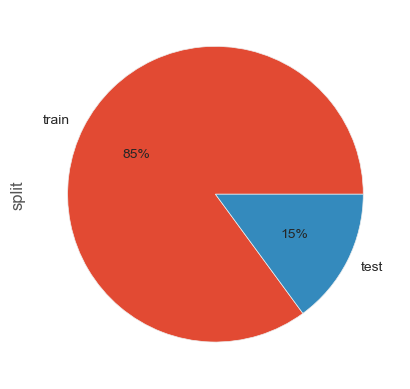

In [23]:
dataset.split.value_counts().plot(kind='pie', autopct='%.0f%%')

In [24]:
from generate_dataset_csv import add_split_column

train_dataset = dataset.query("split == 'train'")
train_dataset.head()

ModuleNotFoundError: No module named 'generate_dataset_csv'

In [ ]:
table_train_class_counts = train_dataset["class"].value_counts()
table_train_class_counts

In [ ]:
# -500 each values
target_number_per_class = 1000
table_n_examples_to_add = target_number_per_class - table_train_class_counts
table_n_examples_to_add = table_n_examples_to_add[table_n_examples_to_add > 0]
table_n_examples_to_add

In [ ]:
original_file_paths_to_augment = []
for class_name, n_examples_to_add in tqdm(table_n_examples_to_add.items(), total=len(table_n_examples_to_add)):
    print(f"> Class {class_name} : {n_examples_to_add} examples to add")

    # get n_examples_to_add random examples from the class
    class_samples_df = train_dataset[train_dataset["class"] == class_name]
    class_examples_file_paths = class_samples_df.sample(min(n_examples_to_add, len(class_samples_df))).index.values
    print(f"  - {len(class_examples_file_paths)} examples to add")

    # duplicate the file paths to reach the target number of examples
    n_duplicates = int(np.ceil(n_examples_to_add / len(class_examples_file_paths)))
    class_examples_file_paths = np.tile(class_examples_file_paths, n_duplicates)[:n_examples_to_add]
    print(f"  - {len(class_examples_file_paths)} examples to add",class_examples_file_paths[:8])

    # add them to the list of files to augment
    original_file_paths_to_augment.extend(class_examples_file_paths)


original_file_paths_to_augment

In [ ]:
files_to_augment = dataset.